In [31]:
import os
os.environ['picaso_refdata'] = '/data/pt426/picaso/reference' #THIS MUST GO BEFORE YOUR IMPORT STATEMENT
os.environ['PYSYN_CDBS'] = '/data/pt426/synphot3/grp/redcat/trds' #this is for the stellar data discussed below.


In [32]:
import warnings
warnings.filterwarnings('ignore')
import picaso.justdoit as jdi
import picaso.justplotit as jpi
import astropy.units as u
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [33]:
#1 ck tables from roxana
mh = '+000' #log metallicity
CtoO = '100'# CtoO ratio relative to solar

ck_db = f'/data/pt426/kcoeff/sonora_2020_feh{mh}_co_{CtoO}.data.196'

In [34]:
cl_run = jdi.inputs(calculation="planet", climate = True) # start a calculation


tint= 300 # Intrinsic Temperature of your Planet in K (set as a high internal temp due to impact residual heat)
grav = 9.34 # Gravity of your Planet in m/s/s

cl_run.gravity(gravity=grav, gravity_unit=u.Unit('m/(s**2)')) # input gravity
cl_run.effective_temp(tint) # input effective temperature

In [35]:
# Notice The keyword ck is set to True because you want to use the correlated-k opacities for your calculation
# and not the line by line opacities
opacity_ck = jdi.opannection(ck_db=ck_db) # grab your opacities

In [36]:
# set to the sun

T_star = 5700 # K, star effective temperature
logg = 4.4 #logg , cgs
metal = 0 # metallicity of star
r_star = 1 # solar radius
semi_major = 1 # star planet distance, AU

cl_run.star(opacity_ck, temp =T_star,metal =metal, logg =logg, radius = r_star,
            radius_unit=u.R_sun,semi_major= semi_major , semi_major_unit = u.AU)#opacity db, pysynphot database, temp, metallicity, logg

In [46]:
nlevel = 91 # number of plane-parallel levels in your code

Teq = 400 # planet equilibrium temperature

pt = cl_run.guillot_pt(Teq, nlevel=nlevel, T_int = tint, p_bottom=np.log10(3000), p_top=-6)
temp_guess = pt['temperature'].values
pressure = pt['pressure'].values

In [47]:
nofczns = 1 # number of convective zones initially. Let's not play with this for now.

nstr_upper = 83 # top most level of guessed convective zone
nstr_deep = nlevel -2 # this is always the case. Dont change this
nstr = np.array([0,nstr_upper,nstr_deep,0,0,0]) # initial guess of convective zones

# Here are some other parameters needed for the code.
rfacv = 0.0 #we are focused on a brown dwarf so let's keep this as is

In [48]:
cl_run.inputs_climate(
    temp_guess=temp_guess, 
    pressure=pressure,
    nstr=nstr, 
    nofczns=nofczns, 
    rfacv=rfacv
    )

# cl_run.atmosphere(df=jdi.pd.DataFrame({
#     'pressure': pressure,
#     'temperature': temp_guess,
#     "H2O": np.zeros_like(pressure) + 1
#     }))

In [49]:
out = cl_run.climate(opacity_ck, save_all_profiles=True,with_spec=True)

Iteration number  0 , min , max temp  366.87051537375334 4570.012351972777 , flux balance  6.837325030000075
Iteration number  1 , min , max temp  284.52484262954323 5199.9 , flux balance  1.9564989289461185
Iteration number  2 , min , max temp  221.0853577254585 5199.9 , flux balance  0.4735415243403904
Iteration number  3 , min , max temp  170.1101472955155 5199.9 , flux balance  0.07926592618770631
Iteration number  4 , min , max temp  125.32735027021063 5199.9 , flux balance  0.0075550656717128
Iteration number  5 , min , max temp  91.47317775807852 5199.9 , flux balance  0.0005238440925557379
Iteration number  6 , min , max temp  91.46158304357328 5199.981697349585 , flux balance  0.0005235288796911434
In t_start: Converged Solution in iterations  6
Big iteration is  91.46158304357328 0
Iteration number  0 , min , max temp  91.44444644937875 5199.9 , flux balance  0.8539805295685774
In t_start: Converged Solution in iterations  0
Profile converged before itmx
Iteration number  0 ,

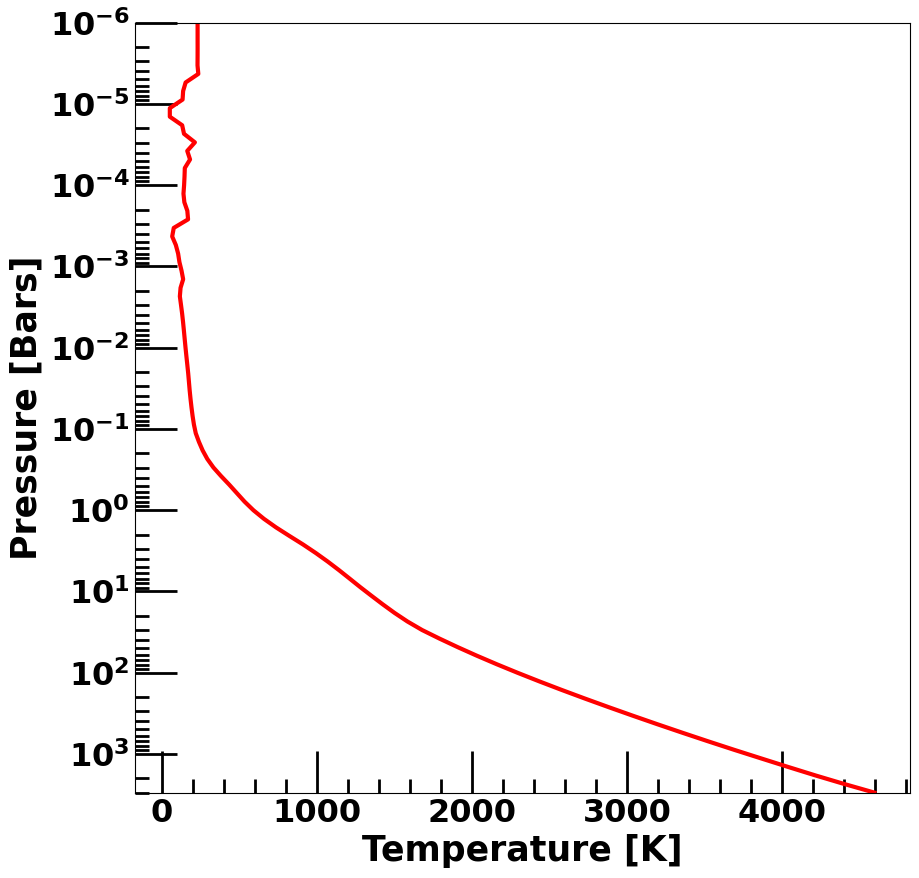

In [50]:
plt.figure(figsize=(10,10))
plt.ylabel("Pressure [Bars]", fontsize=25)
plt.xlabel('Temperature [K]', fontsize=25)

plt.ylim([3e3, 1e-6])

plt.semilogy(out['temperature'],out['pressure'],color="r",linewidth=3,label="Our Run")


plt.minorticks_on()
plt.tick_params(axis='both',which='major',length =30, width=2,direction='in',labelsize=23)
plt.tick_params(axis='both',which='minor',length =10, width=2,direction='in',labelsize=23)

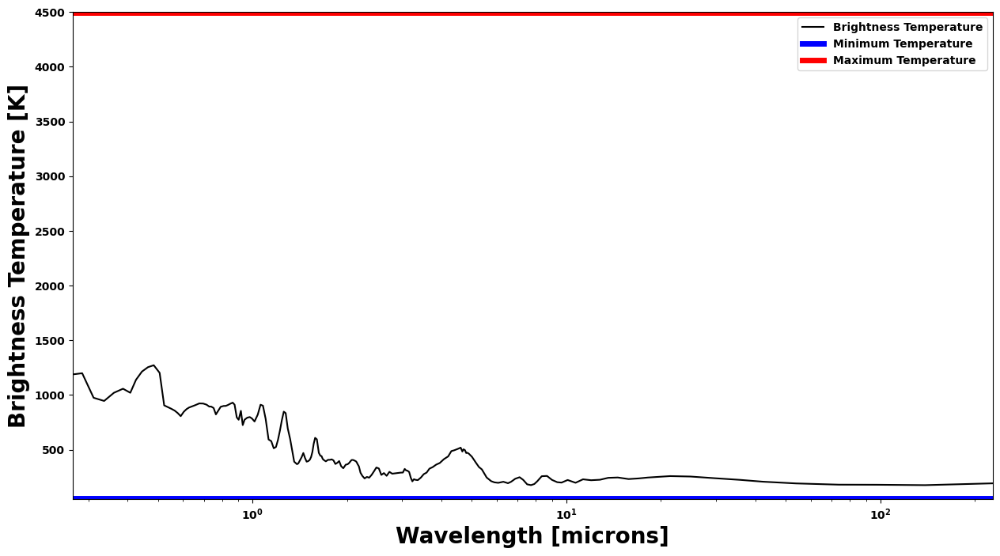

In [42]:
brightness_temp, figure= jpi.brightness_temperature(out['spectrum_output'])

In [43]:
ani = jpi.animate_convergence(out, cl_run, opacity_ck,
    molecules=['H2O','CH4','CO','NH3'])

ani

Animation size has reached 21157430 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
